In [1]:
import importlib as imp
import fullmodel # core.py is a module file that contains the object CDMS
imp.reload(fullmodel)
from fullmodel import plot_full_model, extract_from_tbl, plot_spectrum

In [2]:
moltbl_fn = 'https://docs.google.com/spreadsheets/d/1B4sHLf_wz-8dLeuXcpQO7iRED7mK7Phk61SxGWw5Bok/export?format=csv&gid=1245265514'
figdir = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table/data_model_figs'

results_c = '/blue/adamginsburg/abulatek/brick/symlinks/contsub_smoothed_cubes_K/avg_spectra_core'
results_f = '/blue/adamginsburg/abulatek/brick/symlinks/contsub_smoothed_cubes_K/avg_spectra_frown'
outdir_c = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table/avg_models_core'
outdir_f = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table/avg_models_frown'

# Get list of all spectra
import glob
specfns_c = glob.glob(f"{results_c}/spectrum_*.fits")
specfns_f = glob.glob(f"{results_f}/spectrum_*.fits")

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [03:40<00:00,  4.08s/it]


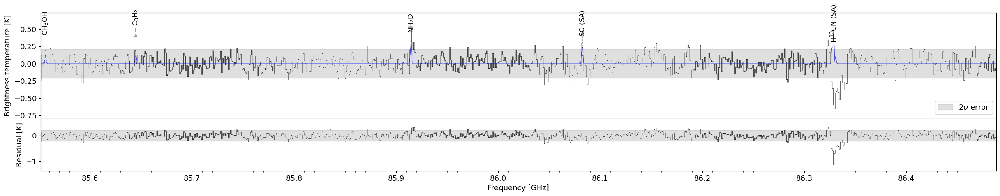

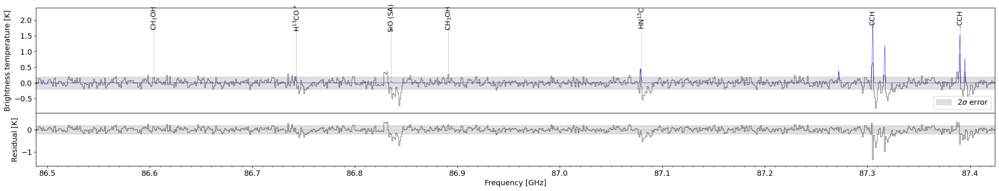

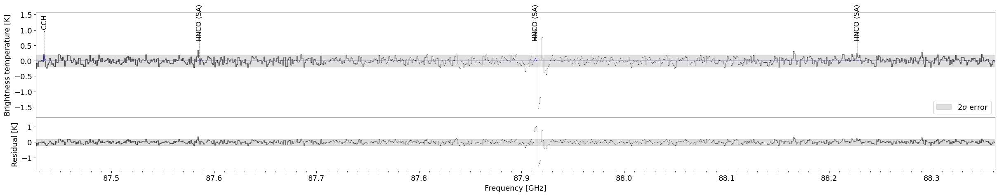

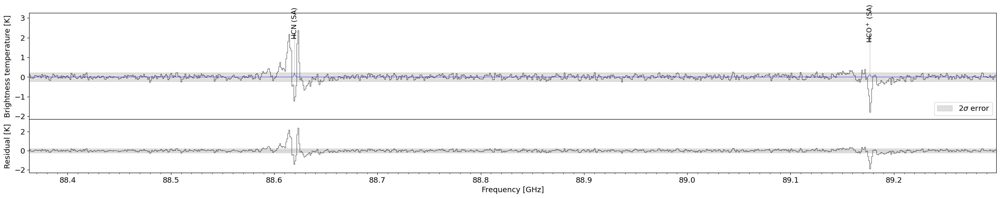

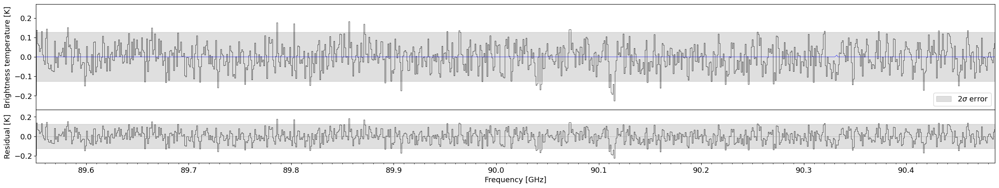

...

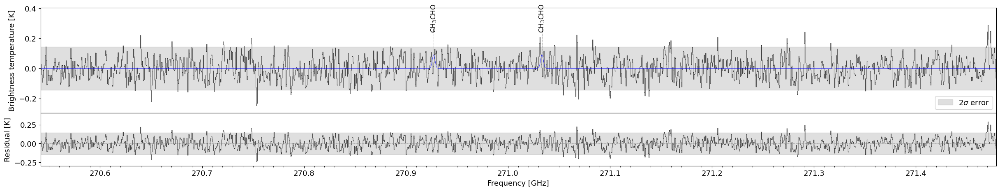

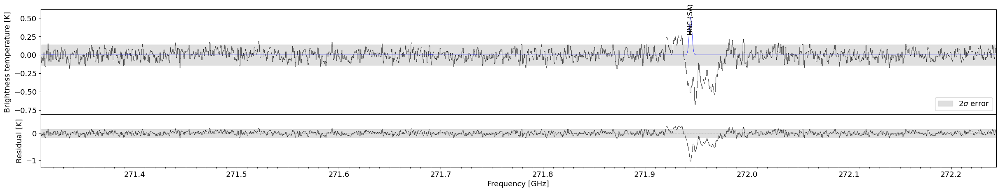

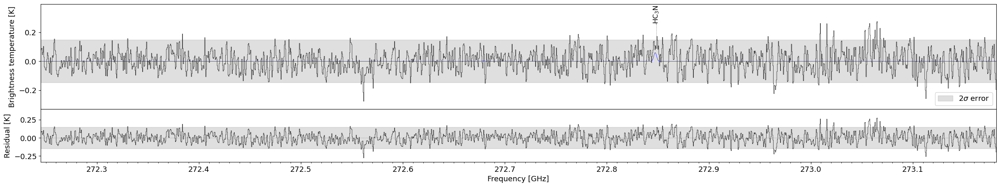

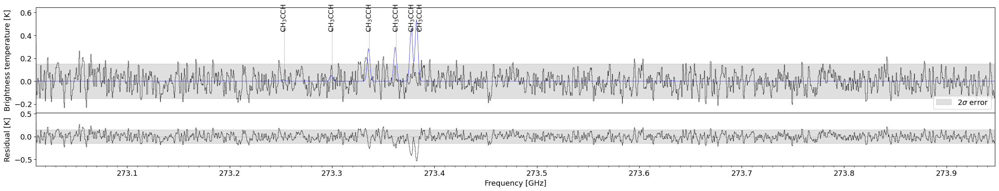

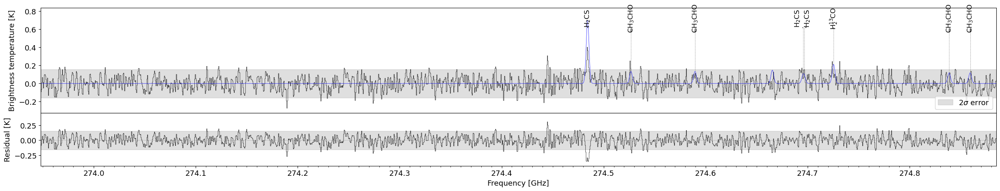

In [3]:
line_tbl_c, freq_centers_c, sigma_c = plot_full_model('core', moltbl_fn, figdir, specfns_c, outdir_c, save_figs=True, show_figs=False, export_tbl=True)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [04:54<00:00,  5.45s/it]


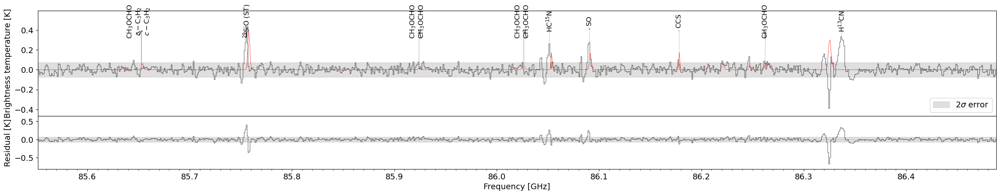

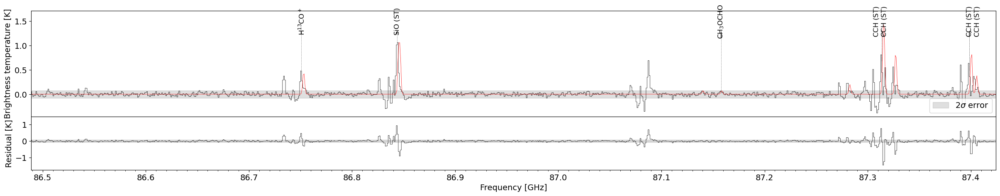

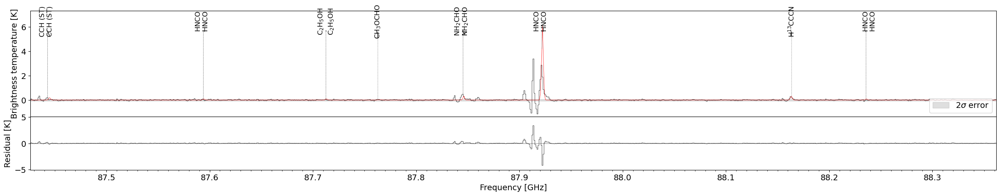

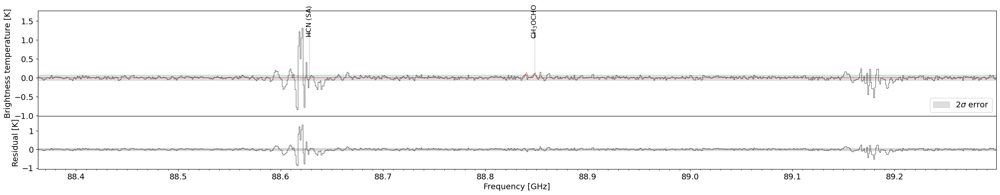

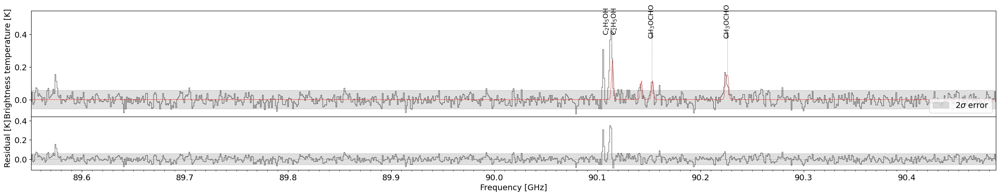

...

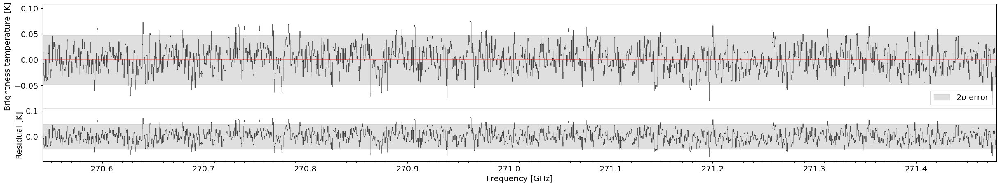

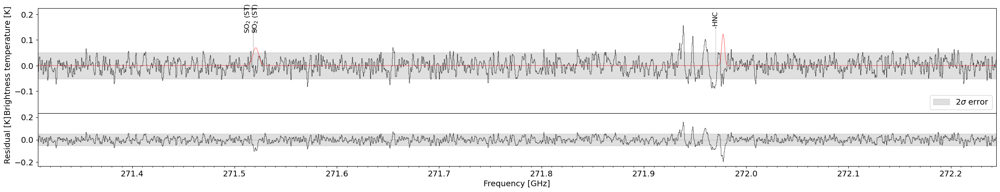

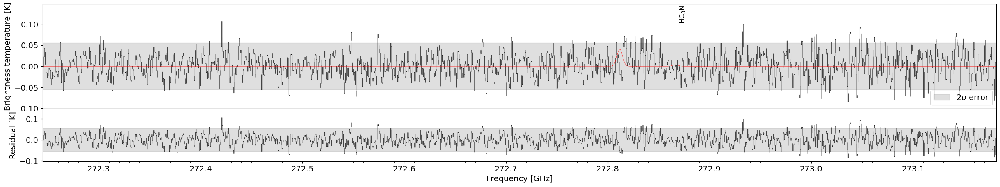

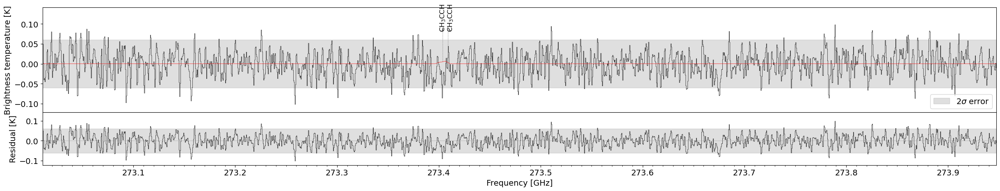

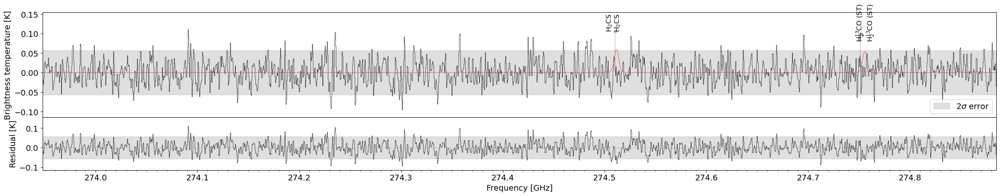

In [4]:
line_tbl_f, freq_centers_f, sigma_f = plot_full_model('frown', moltbl_fn, figdir, specfns_f, outdir_f, save_figs=True, show_figs=False, export_tbl=True)

In [5]:
rs_freqs_c = line_tbl_c['freq_rs_tbl']
rs_freqs_f = line_tbl_f['freq_rs_tbl']

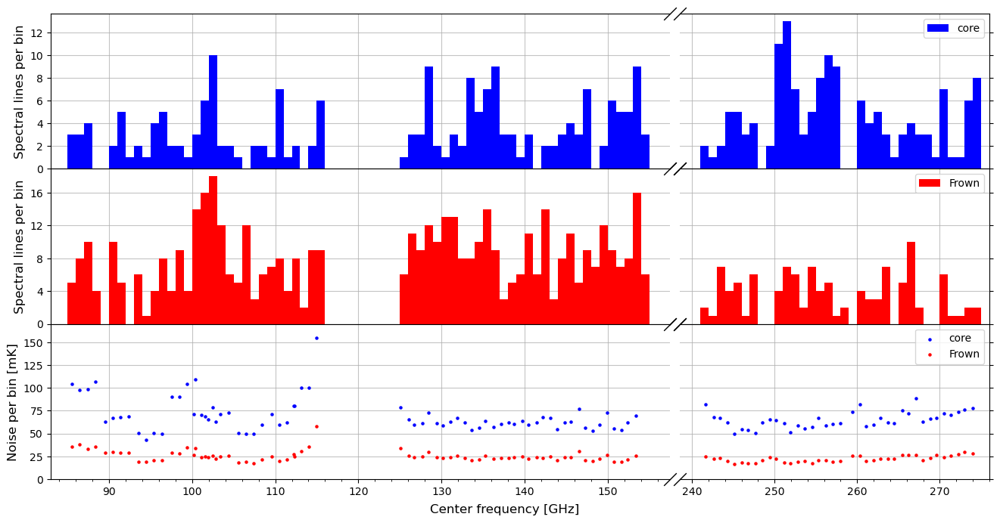

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator
import matplotlib.patches as mpatches

# Make a histogram of number of spectral lines as a function of 1-GHz frequency bins, and noise level per bin
fig = plt.figure(figsize = (16, 8))
gs = fig.add_gridspec(3, 2, hspace = 0, wspace = 0.02, height_ratios=[2,2,2], width_ratios=[2,1])
axs = gs.subplots()

# Plot number of spectral lines per bin in core, with broken axis
for ax in axs[0]:
    ax.hist(rs_freqs_c.value, bins=np.arange(np.floor(rs_freqs_c.value.min()), np.ceil(rs_freqs_c.value.max())+1, 1.), 
            histtype='bar', color='blue', label='core')
# Plot number of spectral lines per bin in frown, with broken axis
for ax in axs[1]:
    ax.hist(rs_freqs_f.value, bins=np.arange(np.floor(rs_freqs_f.value.min()), np.ceil(rs_freqs_f.value.max())+1, 1.), 
            histtype='bar', color='red', label='Frown')

# Crop x-axes and remove unnecessary spines, tick labels, and ticks
for ax in axs:
    ax[0].set_xlim(83, 157.5)
    ax[1].set_xlim(238.5, 276)
    ax[0].spines.right.set_visible(False)
    ax[1].spines.left.set_visible(False)
    ax[1].tick_params(labelleft=False)
    ax[1].yaxis.tick_right()

# Plot noise values and change x tick spacings
for ax in axs[2]:
    ax.scatter(freq_centers_c, sigma_c*1000, s=5, color='blue', label='core')
    ax.scatter(freq_centers_f, sigma_f*1000, s=5, color='red', label='Frown')
    ax.xaxis.set_major_locator(MultipleLocator(10))
    ax.xaxis.set_minor_locator(MultipleLocator(2))

# Need to do this for grids
for ax in axs[0]:
    ax.xaxis.set_major_locator(MultipleLocator(10))
for ax in axs[1]:
    ax.xaxis.set_major_locator(MultipleLocator(10))

# Plot markers for broken axes
# From https://matplotlib.org/stable/gallery/subplots_axes_and_figures/broken_axis.html
d = 1.0  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
for ax in axs:
    ax[0].plot([1, 1], [0, 1], transform=ax[0].transAxes, **kwargs)
    ax[1].plot([0, 0], [0, 1], transform=ax[1].transAxes, **kwargs)

# Set labels
axs[0][0].set_ylabel('Spectral lines per bin', fontsize=12)
axs[1][0].set_ylabel('Spectral lines per bin', fontsize=12)
axs[2][0].set_ylabel('Noise per bin [mK]', fontsize=12)
fig.supxlabel('Center frequency [GHz]', y=0.05, fontsize=12)

# Set other tick spacings
for ax in axs[1]:
    ax.yaxis.set_major_locator(MultipleLocator(4))
for ax in axs[2]:
    ax.set_ylim(0,170)
    ax.yaxis.set_major_locator(MultipleLocator(25))

# Add grid lines on each subplot
for ax in axs:
    for splot in ax:
        splot.set_axisbelow(True)
        splot.grid(alpha=0.75)

for ax in axs:
    ax[1].legend()

plt.tight_layout()
fig_dir = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table'
plt.savefig(fig_dir+'/'+f'brickmaser_line_detection_summary.png', bbox_inches='tight')
plt.savefig(fig_dir+'/'+f'brickmaser_line_detection_summary.pdf', bbox_inches='tight')
plt.show()

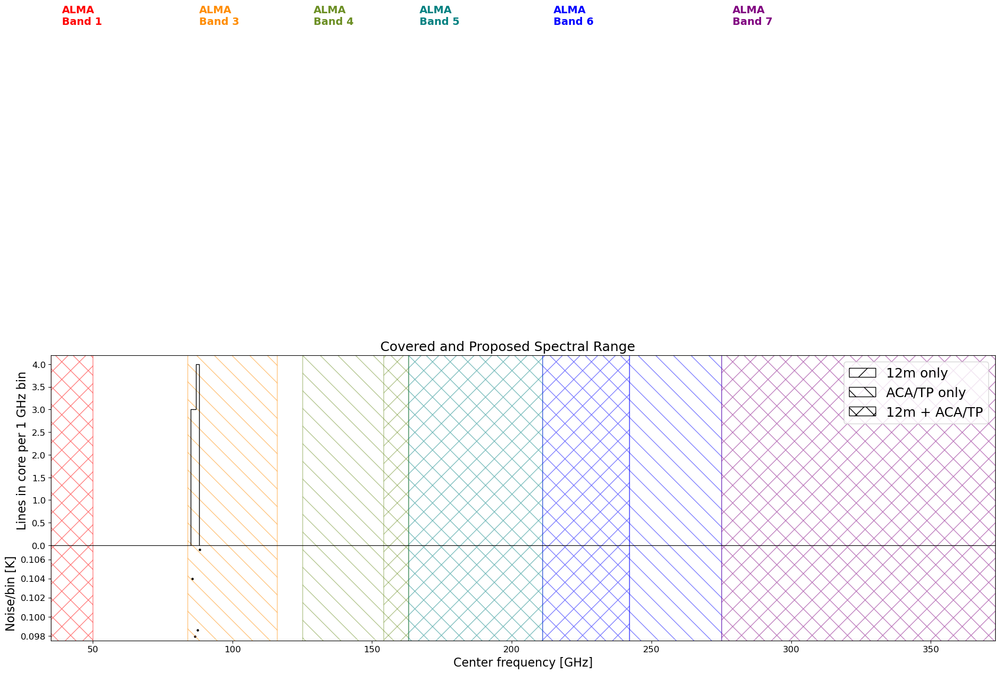

In [11]:
# Use that table for ALMA Cycle 12 resubmission
fig = plt.figure(figsize = (23, 7)) # 23, 7 for ALMA proposal
gs = fig.add_gridspec(2, hspace = 0, height_ratios = [2, 1])
axs = gs.subplots(sharex = True, sharey = False)

fig.suptitle('Covered and Proposed Spectral Range', y = 0.92, fontsize=18)

axs[0].hist(rs_freqs_c.value, bins=np.arange(np.floor(rs_freqs_c.value.min()), np.ceil(rs_freqs_c.value.max())+1, 1.), histtype='step', color='k', label='core')
axs[1].scatter(freq_centers_c, sigma_c, s=5, color='k')

axs[1].set_xlabel('Center frequency [GHz]', fontsize = 16)
axs[0].set_ylabel('Lines in core per 1 GHz bin', fontsize = 16)
axs[1].set_ylabel('Noise/bin [K]', fontsize = 16)

axs[1].set_xlim(35, 373)

# Label them
axs[0].text(35  + 4, 11.5,  'ALMA\nBand 1', fontsize = 14, color = "red", fontweight = "bold")
axs[0].text(84  + 4, 11.5,  'ALMA\nBand 3', fontsize = 14, color = "darkorange", fontweight = "bold")
axs[0].text(125 + 4, 11.5,  'ALMA\nBand 4', fontsize = 14, color = "olivedrab", fontweight = "bold")
axs[0].text(163 + 4, 11.5,  'ALMA\nBand 5', fontsize = 14, color = "teal", fontweight = "bold")
axs[0].text(211 + 4, 11.5,  'ALMA\nBand 6', fontsize = 14, color = "blue", fontweight = "bold")
axs[0].text(275 + 4, 11.5,  'ALMA\nBand 7', fontsize = 14, color = "purple", fontweight = "bold")

# Add patches for proposed spectral regions (top plot)
# hatch options: '/', '\\', '|', '-', '+', 'x', 'o', 'O', '.', '*'
band1p = mpatches.Rectangle((35, -0.02), (50. - 35.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "red") # Band 1 proposed: 12m + ACA
band3p = mpatches.Rectangle((84, -0.02), (116. - 84.), 20, hatch = '\\', alpha = 0.5, fill = 0, ec = "darkorange") # Band 3 proposed: ACA + TP
band4p = mpatches.Rectangle((125, -0.02), (163. - 125.), 20, hatch = '\\', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: ACA + TP
band4p12m = mpatches.Rectangle((154, -0.02), (163. - 154.), 20, hatch = '/', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: 12m (152 - 163 GHz)
band5p = mpatches.Rectangle((163, -0.02), (211. - 163.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "teal") # Band 5 proposed: 12m + ACA + some TP
band6p = mpatches.Rectangle((211, -0.02), (242. - 211.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: 12m + ACA (211 - 242 GHz)
band6pACA = mpatches.Rectangle((242, -0.02), (275. - 242.), 20, hatch = '\\', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: ACA + TP (242 - 275 GHz)
band7p = mpatches.Rectangle((275, -0.02), (373. - 275.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "purple") # Band 7 proposed: 12m + ACA + TP
# Add patches for proposed spectral regions (bottom plot)
# hatch options: '/', '\\', '|', '-', '+', 'x', 'o', 'O', '.', '*'
band1pn = mpatches.Rectangle((35, -0.02), (50. - 35.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "red") # Band 1 proposed: 12m + ACA
band3pn = mpatches.Rectangle((84, -0.02), (116. - 84.), 1, hatch = '\\', alpha = 0.5, fill = 0, ec = "darkorange") # Band 3 proposed: ACA + TP
band4pn = mpatches.Rectangle((125, -0.02), (163. - 125.), 1, hatch = '\\', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: ACA + TP
band4pn12m = mpatches.Rectangle((154, -0.02), (163. - 154.), 1, hatch = '/', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: 12m (152 - 163 GHz)
band5pn = mpatches.Rectangle((163, -0.02), (211. - 163.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "teal") # Band 5 proposed: 12m + ACA + some TP
band6pn = mpatches.Rectangle((211, -0.02), (242. - 211.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: 12m + ACA (211 - 242 GHz)
band6pnACA = mpatches.Rectangle((242, -0.02), (275. - 242.), 1, hatch = '\\', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: ACA + TP (242 - 275 GHz)
band7pn = mpatches.Rectangle((275, -0.02), (373. - 275.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "purple") # Band 7 proposed: 12m + ACA + TP
# Plot them
axs[0].add_patch(band1p)
axs[0].add_patch(band3p)
axs[0].add_patch(band4p)
axs[0].add_patch(band4p12m)
axs[0].add_patch(band5p)
axs[0].add_patch(band6p)
axs[0].add_patch(band6pACA)
axs[0].add_patch(band7p)
axs[1].add_patch(band1pn)
axs[1].add_patch(band3pn)
axs[1].add_patch(band4pn)
axs[1].add_patch(band4pn12m)
axs[1].add_patch(band5pn)
axs[1].add_patch(band6pn)
axs[1].add_patch(band6pnACA)
axs[1].add_patch(band7pn)

axs[0].tick_params(axis='both', which='major', labelsize=12)
axs[1].tick_params(axis='both', which='major', labelsize=12)

# Make a DIY legend
code_artists = [mpatches.Rectangle([0, 0], 0, 0, fill = 0, hatch = '/', color='k'),
                mpatches.Rectangle([0, 0], 0, 0, fill = 0, hatch = '\\', color='k'), 
                mpatches.Rectangle([0, 0], 0, 0, fill = 0, hatch = 'x', color='k')]
code_labels = ["12m only", "ACA/TP only", "12m + ACA/TP"]
axs[0].legend(handles = code_artists, labels = code_labels, loc="upper right", fontsize=18)

plt.rcParams.update({
    "figure.facecolor":  'none',
    "axes.facecolor":    'w',
    "savefig.facecolor": 'none'
})

plt.savefig('/blue/adamginsburg/abulatek/brick/first_results/figures/line_density_proposal.pdf', facecolor = 'w', edgecolor = 'w', bbox_inches = 'tight')
plt.savefig('/blue/adamginsburg/abulatek/brick/first_results/figures/line_density_proposal.png', dpi = 250, bbox_inches = 'tight')
plt.show()

In [14]:
# # Make a KDE of number of spectral lines as a function of 1-GHz frequency bins, and noise level per bin
# fig = plt.figure(figsize = (15, 8))
# gs = fig.add_gridspec(2, hspace = 0, height_ratios = [2, 1])
# axs = gs.subplots(sharex = True, sharey = False)

# # Split lines into two parts
# rs_freqs_c_L = rs_freqs_c[rs_freqs_c.value < 160.]
# rs_freqs_c_U = rs_freqs_c[rs_freqs_c.value > 160.]
# rs_freqs_f_L = rs_freqs_f[rs_freqs_f.value < 160.]
# rs_freqs_f_U = rs_freqs_f[rs_freqs_f.value > 160.]

# # Calculate KDEs from histograms, split into two parts
# from scipy import stats
# kde_c_L = stats.gaussian_kde(rs_freqs_c_L, bw_method=0.01)
# kde_c_U = stats.gaussian_kde(rs_freqs_c_U, bw_method=0.01)
# kde_f_L = stats.gaussian_kde(rs_freqs_f_L, bw_method=0.01)
# kde_f_U = stats.gaussian_kde(rs_freqs_f_U, bw_method=0.01)

# # Plot number of spectral lines per bin
# xvals = np.arange(rs_freqs_c_L.value.min(), rs_freqs_c_L.value.max(), 0.1)
# axs[0].plot(xvals, kde_c_L(xvals), color='tab:blue', label='core')
# axs[0].plot(xvals, kde_c_U(xvals), color='tab:blue')
# axs[0].plot(xvals, kde_f_L(xvals), color='tab:orange', label='frown')
# axs[0].plot(xvals, kde_f_U(xvals), color='tab:orange')

# axs[1].set_xlim(80, 280)

# # Plot noise values
# axs[1].scatter(freq_centers_c, sigma_c, s=5)
# axs[1].scatter(freq_centers_f, sigma_f, s=5)
# noise_axs = axs[1].get_ylim()

# # Set ticks and labels
# axs[1].xaxis.set_major_locator(MultipleLocator(10))
# axs[1].xaxis.set_minor_locator(MultipleLocator(2))
# axs[0].set_ylabel('Number of spectral lines in core per 1 GHz bin')
# axs[1].set_ylabel('Noise per bin [K]')
# axs[1].set_xlabel('Center frequency [GHz]')

# # Put a grey rectange where ALMA can't see between Bands 3 and 4 (116 and 125 GHz)
# b34_dead_u = mpatches.Rectangle((116, -0.02), (125. - 116), 20, alpha = 0.5, facecolor = "grey")
# b34_dead_l = mpatches.Rectangle((116, -0.02), (125. - 116), 20, alpha = 0.5, facecolor = "grey")
# axs[0].add_patch(b34_dead_u)
# axs[1].add_patch(b34_dead_l)
# axs[1].set_ylim(noise_axs[0],noise_axs[1])

# axs[0].legend()

# plt.show()